In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import tldextract
import seaborn as sns


import wordcloud
from wordcloud import WordCloud, STOPWORDS
from collections import Counter

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

from sklearn import metrics
from sklearn.metrics import accuracy_score


print('Libraries imported!')

Libraries imported!


## 4.1 Prepare Data

In [2]:
df = pd.read_csv('173_clean.csv')

In [3]:
vectorizer_t = CountVectorizer()
title_count = vectorizer_t.fit_transform(df['clean_title'].values.astype('U'))

In [4]:
tfidf_transformer = TfidfTransformer()
title_tfidf = tfidf_transformer.fit_transform(title_count)
title_tfidf.shape

(3074756, 54977)

In [60]:
#check the features names and index
for elem in sorted(vectorizer_t.vocabulary_.items())[:10] :
    print(elem[0] , " :" , elem[1] )

aaron  : 0
abandoned  : 1
abbey  : 2
abby  : 3
abcs  : 4
abdominal  : 5
abducted  : 6
abdul  : 7
abena  : 8
abides  : 9


In [61]:
#look at feature matrix in data frame format
title_feature_df = pd.DataFrame(title_tfidf.toarray(), columns = vectorizer_t.get_feature_names())
title_feature_df.head()

,aaron,abandoned,abbey,abby,abcs,abdominal,abducted,abdul,abena,abides,...,zucchini,zuck,zuckerberg,zuhair,zuma,zumba,zumi,zunino,zuri,zwirner
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [62]:
#keyword
vectorizer_k = CountVectorizer()
keyword_count = vectorizer_k.fit_transform(df['clean_keyword'])
tfidf_transformer = TfidfTransformer()
keyword_tfidf = tfidf_transformer.fit_transform(keyword_count)

for elem in sorted(vectorizer_k.vocabulary_.items())[:10] :
    print(elem[0] , " :" , elem[1] )

aaaaaaaaaaaaahhhhhrhrgrgrgrrrgurbhjb  : 0
aaliyah  : 1
aaron  : 2
ababa  : 3
abandoned  : 4
abasolo  : 5
abba  : 6
abbamonte  : 7
abbe  : 8
abbey  : 9


In [63]:
#look at feature matrix in data frame format
keyword_feature_df = pd.DataFrame(keyword_tfidf.toarray(), columns = vectorizer_k.get_feature_names())
keyword_feature_df.head()

,aaaaaaaaaaaaahhhhhrhrgrgrgrrrgurbhjb,aaliyah,aaron,ababa,abandoned,abasolo,abba,abbamonte,abbe,abbey,...,zuckerbrot,zuhair,zuma,zumba,zunino,zurab,zurich,zwill,zwilling,zwirner
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [64]:
print(title_feature_df.shape)
print(keyword_feature_df.shape)

(20000, 12986)
(20000, 17113)


## 4.2 Logistic Regression  to predict scrolldepth_count(0/1) 

#### using title features only

In [65]:
np.random.seed(123)

# X contains corpus (dependent variable)
X_title = title_feature_df
y = df['ScrollDepth_count'].values

from sklearn.model_selection import train_test_split 
X_train, X_test, y_train, y_test = train_test_split(X_title, y, test_size = 0.2) 

logreg = LogisticRegression(solver = 'lbfgs')
logreg.fit(X_train, y_train)


y_pred = logreg.predict(X_test)


print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg.score(X_test, y_test)))
print('AUC score of logistic regression classifier on test set: {:.2f}'.format(metrics.roc_auc_score(y_test, logreg.predict_proba(X_test)[:,1])))

print("")
print(pd.DataFrame(metrics.confusion_matrix(y_test, y_pred)))
print(metrics.classification_report(y_test, y_pred))

Accuracy of logistic regression classifier on test set: 0.74
AUC score of logistic regression classifier on test set: 0.74

      0    1
0  2339  235
1   793  633
              precision    recall  f1-score   support

           0       0.75      0.91      0.82      2574
           1       0.73      0.44      0.55      1426

    accuracy                           0.74      4000
   macro avg       0.74      0.68      0.69      4000
weighted avg       0.74      0.74      0.72      4000



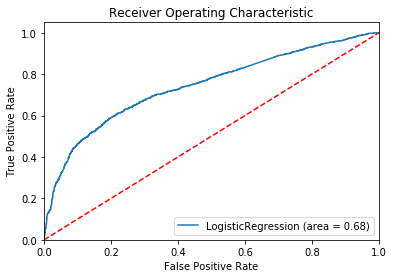

In [66]:
fpr, tpr, thresholds = metrics.roc_curve(y_test, logreg.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='LogisticRegression (area = %0.2f)' % metrics.roc_auc_score(y_test, y_pred))
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

#### Feature Importance: Top20 and Bottom20

In [97]:
 # Get the models coefficients (and top 20 and bottom 20)
logReg_coeff = pd.DataFrame({'feature_name': list(X_title.columns.values), 'model_coefficient': logreg.coef_.transpose().flatten()})
logReg_coeff = logReg_coeff.sort_values('model_coefficient',ascending=False)
logReg_coeff_top = logReg_coeff.head(20)
logReg_coeff_bottom = logReg_coeff.tail(20)
print('logReg_coeff_top', ':', '\n', logReg_coeff_top)
print('')
print('logReg_coeff_bottom', ':', '\n', logReg_coeff_bottom)

logReg_coeff_top : 
       feature_name  model_coefficient
2729       courses           3.963389
1051          best           3.604526
735         awards           2.887061
12501        vogue           2.435802
8318         party           2.341523
9326       recipes           2.249577
949      beautiful           2.187213
12705        where           2.153975
4875        globes           2.115606
7573          most           2.012352
12787       winter           2.007032
2726       couples           1.934784
5541         house           1.934554
601           asia           1.932091
8118         oscar           1.930332
3993         every           1.772189
12024        trips           1.741695
12479        visit           1.736444
5389          high           1.735137
8993      products           1.734054

logReg_coeff_bottom : 
        feature_name  model_coefficient
11153        stream          -1.148548
4396      flatirons          -1.149689
242           album          -1.155016


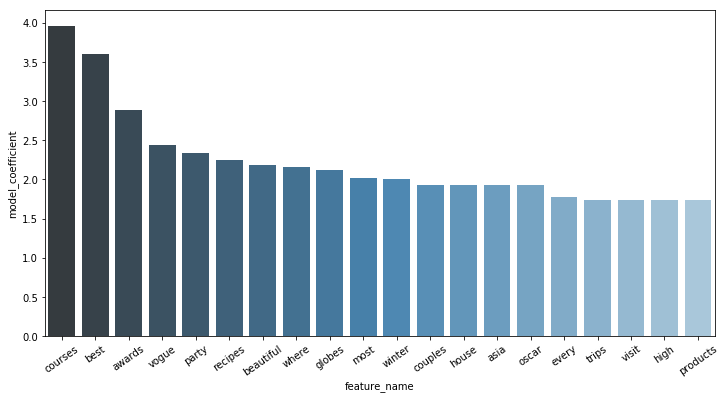

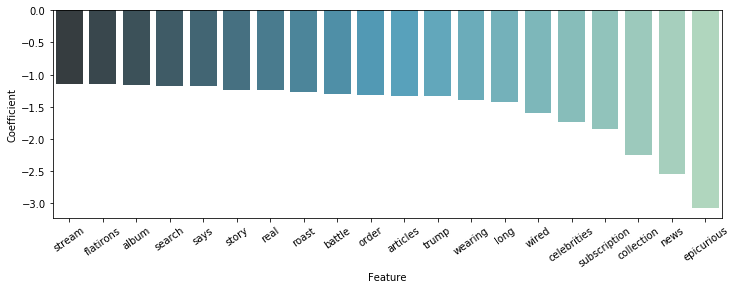

In [98]:
# Plot top 20 coefficients
plt.figure().set_size_inches(12, 6)
fg3 = sns.barplot(x='feature_name', y='model_coefficient',data=logReg_coeff_top, palette="Blues_d")
fg3.set_xticklabels(rotation=35, labels=logReg_coeff_top.feature_name)
# Plot bottom 20 coefficients
plt.figure().set_size_inches(12,6)
fg4 = sns.barplot(x='feature_name', y='model_coefficient',data=logReg_coeff_bottom, palette="GnBu_d")
fg4.set_xticklabels(rotation=35, labels=logReg_coeff_bottom.feature_name)
plt.xlabel('Feature')
plt.ylabel('Coefficient')
plt.subplots_adjust(bottom=0.4)
plt.savefig('figure_4.png')

#### Logistic Regression using keyword features 

Accuracy of logistic regression classifier on test set: 0.76
AUC score of logistic regression classifier on test set: 0.81

      0    1
0  2239  335
1   613  813
              precision    recall  f1-score   support

           0       0.79      0.87      0.83      2574
           1       0.71      0.57      0.63      1426

   micro avg       0.76      0.76      0.76      4000
   macro avg       0.75      0.72      0.73      4000
weighted avg       0.76      0.76      0.76      4000



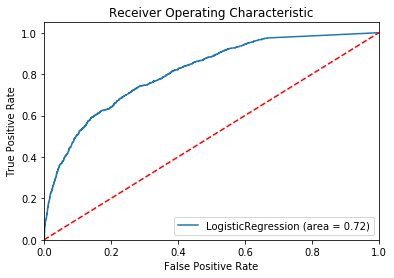

In [99]:
np.random.seed(123)

# X contains corpus (dependent variable)
X_keyword = keyword_feature_df
y = df['ScrollDepth_count'].values

from sklearn.model_selection import train_test_split 
X_train, X_test, y_train, y_test = train_test_split(X_keyword, y, test_size = 0.2) 

logreg = LogisticRegression(solver = 'lbfgs')
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)


print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg.score(X_test, y_test)))
print('AUC score of logistic regression classifier on test set: {:.2f}'.format(metrics.roc_auc_score(y_test, logreg.predict_proba(X_test)[:,1])))

print("")
print(pd.DataFrame(metrics.confusion_matrix(y_test, y_pred)))
print(metrics.classification_report(y_test, y_pred))

fpr, tpr, thresholds = metrics.roc_curve(y_test, logreg.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='LogisticRegression (area = %0.2f)' % metrics.roc_auc_score(y_test, y_pred))
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

#### Keyword Feature Importance 

In [100]:
 # Get the models coefficients (and top 20 and bottom 20)
logReg_coeff = pd.DataFrame({'feature_name': list(X_keyword.columns.values), 'model_coefficient': logreg.coef_.transpose().flatten()})
logReg_coeff = logReg_coeff.sort_values('model_coefficient',ascending=False)
logReg_coeff_top = logReg_coeff.head(20)
logReg_coeff_bottom = logReg_coeff.tail(20)
print('logReg_coeff_top', ':', '\n', logReg_coeff_top)
print('')
print('logReg_coeff_bottom', ':', '\n', logReg_coeff_bottom)

logReg_coeff_top : 
       feature_name  model_coefficient
2543        carpet           3.108458
2665     celebrity           2.753333
994          award           2.514189
474        america           2.376542
12497      ranking           2.210276
4239   destination           2.127186
11311        paris           2.068535
14776        story           1.984441
3185    cntraveler           1.931683
1286         beach           1.919631
14223        snack           1.786016
12551       reader           1.714573
9990         milan           1.609399
5201      exercise           1.596874
9103         lower           1.570526
14864      stylish           1.500853
5990       gallery           1.480999
15021        sushi           1.456205
8913      lingerie           1.451415
8133          karl           1.449697

logReg_coeff_bottom : 
        feature_name  model_coefficient
6352           golf          -1.245952
10413      mushroom          -1.259045
11836       podcast          -1.262298


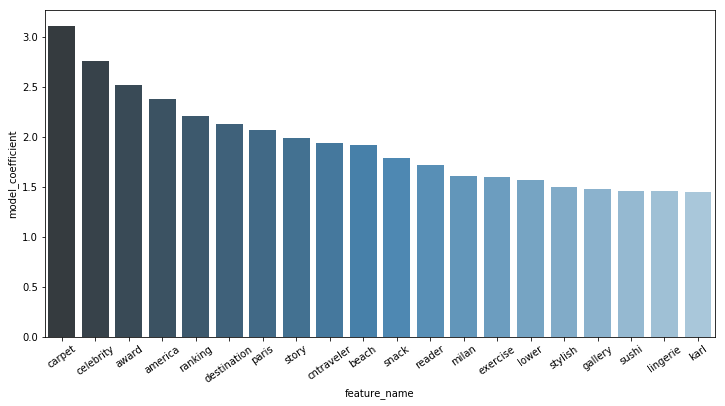

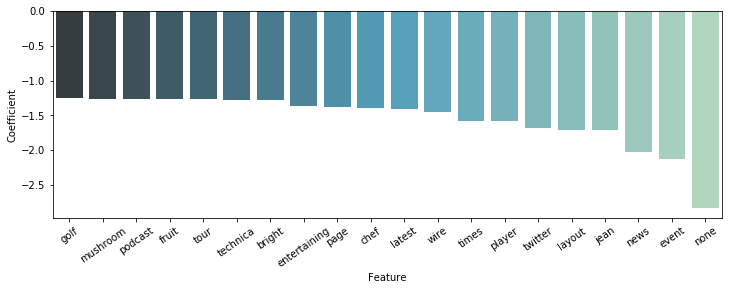

In [101]:
# Plot top 20 coefficients
plt.figure().set_size_inches(12, 6)
fg3 = sns.barplot(x='feature_name', y='model_coefficient',data=logReg_coeff_top, palette="Blues_d")
fg3.set_xticklabels(rotation=35, labels=logReg_coeff_top.feature_name)
# Plot bottom 20 coefficients
plt.figure().set_size_inches(12,6)
fg4 = sns.barplot(x='feature_name', y='model_coefficient',data=logReg_coeff_bottom, palette="GnBu_d")
fg4.set_xticklabels(rotation=35, labels=logReg_coeff_bottom.feature_name)
plt.xlabel('Feature')
plt.ylabel('Coefficient')
plt.subplots_adjust(bottom=0.4)
plt.savefig('figure_4.png')

### Add other variables: 
#### 'Brand', 'Channel', 'Category', 'Location', 'Country', 'Browser', 'Referer', 'Author1'

In [67]:
df.columns

Index(['index', 'InfinityID', 'UUID', 'Brand', 'Channel', 'Author', 'Category',
       'Location', 'Country', 'ScrollDepth', 'Browser', 'ScrollDepth_count',
       'Referer', 'Author1', 'gender', 'cut_q', 'clean_title',
       'clean_keyword'],
      dtype='object')

In [68]:
# check unique categorical data in the each column
for col in df:
    print (col, len(df[col].unique()))

index 20000
InfinityID 17171
UUID 18816
Brand 18
Channel 275
Author 2103
Category 4
Location 2965
Country 65
ScrollDepth 559
Browser 39
ScrollDepth_count 2
Referer 241
Author1 1884
gender 6
cut_q 5
clean_title 11189
clean_keyword 9529


In [69]:
df.isnull().sum()

index                0
InfinityID           0
UUID                 0
Brand                0
Channel              0
Author               0
Category             0
Location             0
Country              0
ScrollDepth          0
Browser              0
ScrollDepth_count    0
Referer              0
Author1              0
gender               0
cut_q                0
clean_title          0
clean_keyword        0
dtype: int64

## 4.3 Random Forest Model
### 4.3.1 H2O Random Forest for Variables Pre-Selection

In [99]:
df_h2o = df.drop(['index',"InfinityID","UUID","cut_q","ScrollDepth","Author"], axis=1)
X = pd.DataFrame(df_h2o["ScrollDepth_count"])
df_h2o = df_h2o.drop(['ScrollDepth_count'], axis=1)
df_h2o = pd.concat([df_h2o, X], axis=1)
df_h2o.head(n=3)

,Brand,Channel,Category,Location,Country,Browser,Referer,Author1,gender,clean_title,clean_keyword,ScrollDepth_count
0,bon-appetit,recipes,general,White Plains,United States,Mobile Safari,google,'bon appétit',andy,bean recipes making year long,bean,0
1,epicurious,recipes,general,Wantagh,United States,Chrome Mobile,android_app,,unknown,cabbage soup,none,0
2,vanity-fair,news,general,Asbury Park,United States,Mobile Safari UI/WKWebView,facebook,'tina nguyen',female,nancy pelosi pulls rank suspends trump state u...,nancy pelosi state union address donald trump ...,0


In [100]:
df_h2o["ScrollDepth_count"].value_counts()

0    12762
1     7238
Name: ScrollDepth_count, dtype: int64

In [101]:
scrollD_0 = df_h2o[df_h2o.ScrollDepth_count==0]
scrollD_1 = df_h2o[df_h2o.ScrollDepth_count==1]

In [102]:
#resample data to handle the imbalanced dataset
from sklearn.utils import resample

scrollD_0_downsampled = resample(scrollD_0,
                                replace = False, # sample without replacement
                                n_samples = len(scrollD_1), # match minority n
                                random_state = 1234) # reproducible results

downsampled = pd.concat([scrollD_0_downsampled, scrollD_1])

downsampled.shape

(14476, 12)

In [225]:
# # get dummy 
# df_h2o_dummy = df.drop(['Author',"Country"], axis=1)
# df_h2o_dummy = pd.get_dummies(df_h2o[['Brand', 'Channel', 'Category', 'Location', 
#                                       'Browser', 'Referer', 'Author1','gender','clean_title', 'clean_keyword']], drop_first=True)
# X = pd.DataFrame(df_h2o["ScrollDepth_count"])
# df_h2o_dummy = pd.concat([df_h2o_dummy, X], axis=1)


#### 1. H2O variable pre-selection

In [103]:
from sklearn.model_selection import train_test_split
from h2o.estimators.random_forest import H2ORandomForestEstimator

In [104]:
train, test = train_test_split(downsampled, test_size=0.3, random_state=1234)
train.shape

(10133, 12)

In [105]:
# inbalanced data
train["ScrollDepth_count"].value_counts()

0    5087
1    5046
Name: ScrollDepth_count, dtype: int64

In [77]:
#!pip install imbalanced-learn

In [116]:
h2o.cluster().shutdown()

H2O session _sid_9c7e closed.


In [117]:
import h2o
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 ..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "1.8.0_152-release"; OpenJDK Runtime Environment (build 1.8.0_152-release-1056-b12); OpenJDK 64-Bit Server VM (build 25.152-b12, mixed mode)
  Starting server from /Users/rona/anaconda3/lib/python3.7/site-packages/h2o/backend/bin/h2o.jar
  Ice root: /var/folders/6g/3frgx06978l_s5pqjdqz50qr0000gn/T/tmpjryzhoeg
  JVM stdout: /var/folders/6g/3frgx06978l_s5pqjdqz50qr0000gn/T/tmpjryzhoeg/h2o_rona_started_from_python.out
  JVM stderr: /var/folders/6g/3frgx06978l_s5pqjdqz50qr0000gn/T/tmpjryzhoeg/h2o_rona_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O cluster uptime:,02 secs
H2O cluster timezone:,America/New_York
H2O data parsing timezone:,UTC
H2O cluster version:,3.26.0.10
H2O cluster version age:,29 days
H2O cluster name:,H2O_from_python_rona_oie0yi
H2O cluster total nodes:,1
H2O cluster free memory:,3.556 Gb
H2O cluster total cores:,8
H2O cluster allowed cores:,8
H2O cluster status:,"accepting new members, healthy"


In [118]:
target='ScrollDepth_count'

In [119]:
predictors= train.columns[:-1].tolist()

In [121]:
train_hex = h2o.H2OFrame(train)
test_hex = h2o.H2OFrame(test)

Parse progress: |█████████████████████████████████████████████████████████| 100%
Parse progress: |█████████████████████████████████████████████████████████| 100%


In [122]:
rf_v1 = H2ORandomForestEstimator(
        model_id = 'rf_v1',
        ntrees = 300,
        nfolds=10,
        min_rows=100,
        seed=123)
rf_v1.train(predictors,target,training_frame=train_hex)

drf Model Build progress: |███████████████████████████████████████████████| 100%


In [123]:
rf_v1

Model Details
H2ORandomForestEstimator :  Distributed Random Forest
Model Key:  rf_v1


Model Summary: 


,,number_of_trees,number_of_internal_trees,model_size_in_bytes,min_depth,max_depth,mean_depth,min_leaves,max_leaves,mean_leaves
0,,300.0,300.0,325499.0,7.0,13.0,10.013333,30.0,49.0,43.233334




ModelMetricsRegression: drf
** Reported on train data. **

MSE: 0.16330034225999232
RMSE: 0.4041043705034534
MAE: 0.3430173686576145
RMSLE: 0.28428507778410184
Mean Residual Deviance: 0.16330034225999232

ModelMetricsRegression: drf
** Reported on cross-validation data. **

MSE: 0.16437865132784985
RMSE: 0.4054363714910761
MAE: 0.34523573891748216
RMSLE: 0.2851322048859202
Mean Residual Deviance: 0.16437865132784985

Cross-Validation Metrics Summary: 


,,mean,sd,cv_1_valid,cv_2_valid,cv_3_valid,cv_4_valid,cv_5_valid,cv_6_valid,cv_7_valid,cv_8_valid,cv_9_valid,cv_10_valid
0,mae,0.34527367,0.0049631046,0.3518869,0.34196514,0.33743876,0.3479589,0.34575585,0.34485263,0.34205183,0.3430434,0.35420537,0.3435781
1,mean_residual_deviance,0.1644034,0.003140513,0.17046027,0.16372027,0.15874591,0.16428638,0.16406699,0.16453989,0.16235915,0.16385847,0.16822283,0.1637737
2,mse,0.1644034,0.003140513,0.17046027,0.16372027,0.15874591,0.16428638,0.16406699,0.16453989,0.16235915,0.16385847,0.16822283,0.1637737
3,r2,0.3418377,0.012545186,0.31815824,0.344925,0.36490467,0.34259465,0.3426124,0.3412844,0.35045514,0.34434083,0.32661676,0.34248504
4,residual_deviance,0.1644034,0.003140513,0.17046027,0.16372027,0.15874591,0.16428638,0.16406699,0.16453989,0.16235915,0.16385847,0.16822283,0.1637737
5,rmse,0.40545028,0.0038675151,0.41286835,0.4046236,0.3984293,0.40532255,0.40505183,0.40563518,0.40293816,0.40479437,0.41014978,0.40468964
6,rmsle,0.28513774,0.0030150274,0.29038104,0.28383854,0.28064469,0.2857909,0.28288698,0.2867113,0.28119537,0.2855336,0.28681427,0.28758058



Scoring History: 


,,timestamp,duration,number_of_trees,training_rmse,training_mae,training_deviance
0,,2019-12-06 18:25:12,52.724 sec,0.0,NaN,NaN,NaN
1,,2019-12-06 18:25:12,52.746 sec,1.0,0.440601,0.352482,0.194129
2,,2019-12-06 18:25:12,52.761 sec,2.0,0.433861,0.352593,0.188236
3,,2019-12-06 18:25:12,52.778 sec,3.0,0.425460,0.345635,0.181016
4,,2019-12-06 18:25:12,52.798 sec,4.0,0.421626,0.343430,0.177768
5,,2019-12-06 18:25:12,52.812 sec,5.0,0.420546,0.344345,0.176859
6,,2019-12-06 18:25:12,52.827 sec,6.0,0.416952,0.342022,0.173849
7,,2019-12-06 18:25:12,52.842 sec,7.0,0.415049,0.342730,0.172266
8,,2019-12-06 18:25:12,52.856 sec,8.0,0.413448,0.341758,0.170939
9,,2019-12-06 18:25:12,52.873 sec,9.0,0.412396,0.342204,0.170071



See the whole table with table.as_data_frame()

Variable Importances: 


,variable,relative_importance,scaled_importance,percentage
0,Channel,59233.898438,1.000000,0.286599
1,Category,51064.945312,0.862090,0.247074
2,Author1,33900.750000,0.572320,0.164027
3,Brand,18139.576172,0.306236,0.087767
4,gender,12643.190430,0.213445,0.061173
5,Referer,12106.101562,0.204378,0.058575
6,clean_keyword,7788.810547,0.131492,0.037686
7,Browser,5560.371582,0.093871,0.026903
8,clean_title,5226.294434,0.088231,0.025287
9,Location,1014.477905,0.017127,0.004908


#### 2. Top ten Important Variables

In [124]:
rf_v1.varimp(True).head(n=10)

,variable,relative_importance,scaled_importance,percentage
0,Channel,59233.898438,1.000000,0.286599
1,Category,51064.945312,0.862090,0.247074
2,Author1,33900.750000,0.572320,0.164027
3,Brand,18139.576172,0.306236,0.087767
4,gender,12643.190430,0.213445,0.061173
5,Referer,12106.101562,0.204378,0.058575
6,clean_keyword,7788.810547,0.131492,0.037686
7,Browser,5560.371582,0.093871,0.026903
8,clean_title,5226.294434,0.088231,0.025287
9,Location,1014.477905,0.017127,0.004908


In [125]:
df_h2o.head(n=3)

,Brand,Channel,Category,Location,Country,Browser,Referer,Author1,gender,clean_title,clean_keyword,ScrollDepth_count
0,bon-appetit,recipes,general,White Plains,United States,Mobile Safari,google,'bon appétit',andy,bean recipes making year long,bean,0
1,epicurious,recipes,general,Wantagh,United States,Chrome Mobile,android_app,,unknown,cabbage soup,none,0
2,vanity-fair,news,general,Asbury Park,United States,Mobile Safari UI/WKWebView,facebook,'tina nguyen',female,nancy pelosi pulls rank suspends trump state union,nancy pelosi state union address donald trump state congress house...,0


In [126]:
df_h2o.shape

(20000, 12)

In [131]:
df_h2o_dummy = pd.get_dummies(df_h2o[['Brand', 'Channel', 'Category', 
                                      'Referer', 'Author1','gender']], drop_first=True)
sc = pd.DataFrame(df_h2o["ScrollDepth_count"])
df_h2o_dummy = pd.concat([df_h2o_dummy, sc], axis=1)

df_h2o_dummy.shape

(20000, 2423)

In [132]:
df_h2o_dummy.head(n=3)

,Brand_architectural-digest,Brand_ars-technica,Brand_bon-appetit,Brand_brides,Brand_conde-nast-traveler,Brand_epicurious,Brand_glamour,Brand_golf-digest,Brand_gq,Brand_pitchfork,...,Author1_'zoë ligon',Author1_'zoë sessums',Author1_'zoë weiner',Author1_'zz packer',gender_female,gender_male,gender_mostly_female,gender_mostly_male,gender_unknown,ScrollDepth_count
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


### 4.3.2 Build Random Forest Model (Scikit-Learn)

In [154]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_regression
from sklearn import datasets, linear_model
from matplotlib.legend_handler import HandlerLine2D
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.tree import export_graphviz
from IPython.display import Image

In [136]:
features_dummy=df_h2o_dummy.columns[:-1].tolist()

In [137]:
Y = df_h2o_dummy['ScrollDepth_count']
X =  df_h2o_dummy[features_dummy]

In [143]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.3, random_state=100)

In [144]:
# imbalanced data
df_h2o_dummy["ScrollDepth_count"].value_counts()

0    12762
1     7238
Name: ScrollDepth_count, dtype: int64

In [147]:
# Resampling data with Oversample
data_temp = pd.concat([X_train, Y_train], axis=1)

sc_d_0 = data_temp[data_temp.ScrollDepth_count==0]
sc_d_1 = data_temp[data_temp.ScrollDepth_count==1]

sc_d_1_upsampled = resample(sc_d_1,
                          replace=True, 
                          n_samples=len(sc_d_0), 
                          random_state=100) 

upsampled = pd.concat([sc_d_0, sc_d_1_upsampled])


In [148]:
#balanced data
upsampled.ScrollDepth_count.value_counts()

1    9020
0    9020
Name: ScrollDepth_count, dtype: int64

In [151]:
Y_train = upsampled.ScrollDepth_count
X_train = upsampled.drop('ScrollDepth_count', axis=1)

In [152]:
train_scores = []
test_scores = []
rf = RandomForestClassifier(warm_start=True)
estimator_range = range(300, 1000, 50)
for n_estimators in estimator_range:
    rf.n_estimators = n_estimators
    rf.fit(X_train, Y_train)
    train_scores.append(rf.score(X_train, Y_train))
    test_scores.append(rf.score(X_test, Y_test))

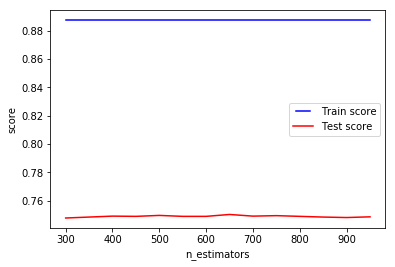

In [155]:
n_estimators = [*range(300, 1000, 50)]
line1, = plt.plot(n_estimators, train_scores, 'b', label='Train score')
line2, = plt.plot(n_estimators, test_scores, 'r', label='Test score')
plt.legend(handler_map={line1: HandlerLine2D(numpoints=2)})
plt.ylabel('score')
plt.xlabel('n_estimators')
plt.show()

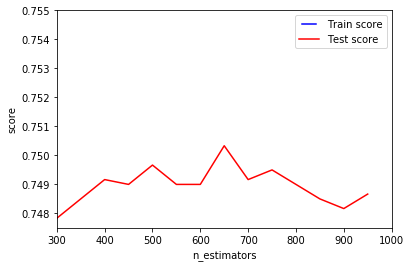

In [161]:
#zoom in
line1, = plt.plot(n_estimators, train_scores, 'b', label='Train score')
line2, = plt.plot(n_estimators, test_scores, 'r', label='Test score')
plt.legend(handler_map={line1: HandlerLine2D(numpoints=2)})
plt.ylabel('score')
plt.xlabel('n_estimators')
plt.ylim(0.7475,0.755)
plt.xlim(300,1000)
plt.show()

In [162]:
rf_optimal = RandomForestClassifier(n_estimators = 650, random_state = 123) 
rf_optimal.fit(X_train, Y_train)  

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=650,
                       n_jobs=None, oob_score=False, random_state=123,
                       verbose=0, warm_start=False)

In [202]:
rf_optimal_pred = rf_optimal.predict(X_test)

In [255]:
accuracy_score(Y_test, rf_optimal_pred)

0.7495

In [222]:
print("Accuracy", metrics.accuracy_score(Y_test, rf_optimal_pred))

Accuracy 0.7495


In [205]:
f1_score(Y_test, rf_optimal_pred)

0.674745726033326

In [207]:
recall_score(Y_test, rf_optimal_pred)

0.6904340124003543

      0     1
0  2938   804
1   699  1559
              precision    recall  f1-score   support

           0       0.81      0.79      0.80      3742
           1       0.66      0.69      0.67      2258

    accuracy                           0.75      6000
   macro avg       0.73      0.74      0.74      6000
weighted avg       0.75      0.75      0.75      6000



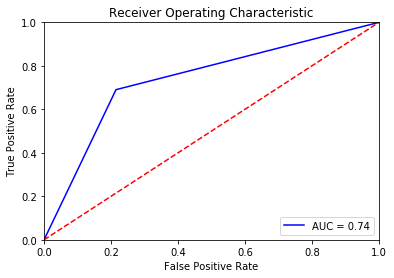

In [228]:
print(pd.DataFrame(metrics.confusion_matrix(Y_test, rf_optimal_pred)))
print(metrics.classification_report(Y_test, rf_optimal_pred))

fpr, tpr, threshold = metrics.roc_curve(Y_test, rf_optimal_pred)
roc_auc = metrics.auc(fpr, tpr)
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [296]:
!pip install graphviz

In [304]:
!pip install pydotplus

    100% |████████████████████████████████| 286kB 2.9MB/s ta 0:00:01
  Running setup.py bdist_wheel for pydotplus ... done
  Stored in directory: /Users/rona/Library/Caches/pip/wheels/35/7b/ab/66fb7b2ac1f6df87475b09dc48e707b6e0de80a6d8444e3628
Successfully built pydotplus


In [297]:
estimator = rf_optimal.estimators_[0]
estimator

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=843828734, splitter='best')

In [306]:
# Export as dot file
export_graphviz(estimator, out_file='tree1.dot', feature_names = X_train.columns,
                rounded = True, filled = True)

In [309]:
!dot -Tpng tree1.dot -o tree1.png

Error: tree1.dot: syntax error in line 411 near '''


In [360]:
#Image(filename = 'tree1.png')

#### add limited : max_depth = 5

In [191]:
rf_limited = RandomForestClassifier(n_estimators = 650,max_depth = 5, random_state = 123)
rf_limited.fit(X_train, Y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=5, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=650,
                       n_jobs=None, oob_score=False, random_state=123,
                       verbose=0, warm_start=False)

In [208]:
rf_limited_pred = rf_limited.predict(X_test)


In [209]:
accuracy_score(Y_test, rf_limited_pred)

0.6853333333333333

In [230]:
f1_score(Y_test, rf_limited_pred)

0.6571013439883764

In [192]:
estimator_limited = rf_limited.estimators_[5]
estimator_limited

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=5, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=819844194, splitter='best')

In [193]:
export_graphviz(estimator_limited, out_file='tree_limited.dot', feature_names = X_train.columns,
                rounded = True, filled = True)

In [194]:
!dot -Tpng tree_limited.dot -o tree_limited.png

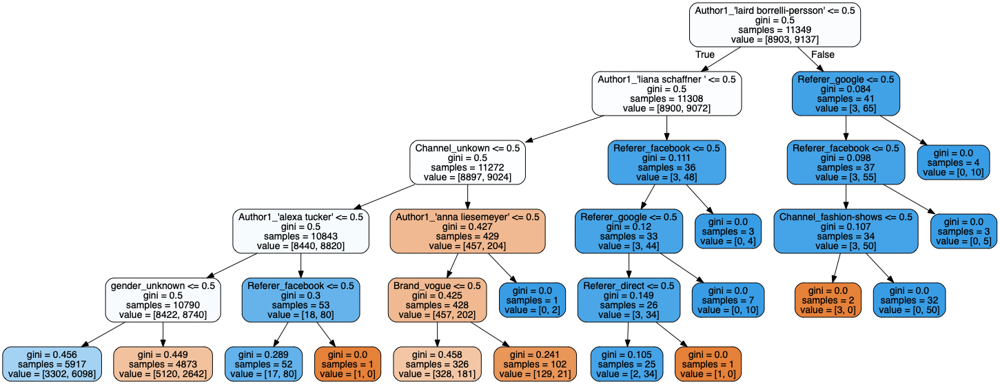

In [195]:
Image(filename = 'tree_limited.png')

#### Random Forest Grid Search

In [313]:
from sklearn.model_selection import GridSearchCV

In [310]:
RF = RandomForestClassifier(random_state=123)

In [317]:
param_grid = {
    'n_estimators': [650],
    'max_depth': [5, 15, 25, 50]
   }

In [320]:
gs = GridSearchCV(estimator=RF, param_grid=param_grid)
gs.fit(X_train, Y_train)

GridSearchCV(cv=None, error_score=nan,
             estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                              class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              max_samples=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators=100, n_jobs=None,
                                              oob_score=False, random_state=123,
                              

In [321]:
gs.best_params_

{'max_depth': 50, 'n_estimators': 650}

In [322]:
rf1 = RandomForestClassifier(n_estimators = 650,max_depth = 50, random_state = 123)
rf1.fit(X_train, Y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=50, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=650,
                       n_jobs=None, oob_score=False, random_state=123,
                       verbose=0, warm_start=False)

In [323]:
rf1_pred = rf1.predict(X_test)

In [325]:
accuracy_score(Y_test, rf1_pred)

0.7466666666666667

In [326]:
f1_score(Y_test, rf1_pred)

0.683991683991684

In [327]:
recall_score(Y_test, rf1_pred)

0.7285208148804252

      0     1
0  2835   907
1   613  1645
              precision    recall  f1-score   support

           0       0.82      0.76      0.79      3742
           1       0.64      0.73      0.68      2258

    accuracy                           0.75      6000
   macro avg       0.73      0.74      0.74      6000
weighted avg       0.76      0.75      0.75      6000



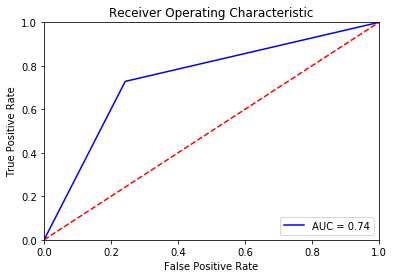

In [328]:
print(pd.DataFrame(metrics.confusion_matrix(Y_test, rf1_pred)))
print(metrics.classification_report(Y_test, rf1_pred))

fpr, tpr, threshold = metrics.roc_curve(Y_test, rf1_pred)
roc_auc = metrics.auc(fpr, tpr)
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

#### Important Variables

In [349]:
feature_importances = pd.DataFrame(rf1.feature_importances_,
                                   index = X_train.columns,
                                    columns=['importance']).sort_values('importance',ascending=False)
feature_importances.head(n=20)

,importance
Category_general,0.103533
Category_amp,0.098866
gender_unknown,0.059094
gender_female,0.032511
Brand_conde-nast-traveler,0.023192
Referer_google,0.021983
Referer_direct,0.021708
Brand_vogue,0.021150
Referer_facebook,0.013095
Channel_unkown,0.012873


In [350]:
estimator_5 = rf1.estimators_[5]
estimator_5

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=50, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=819844194, splitter='best')

In [330]:
# export_graphviz(estimator_5, out_file='tree_5.dot', feature_names = X_train.columns,
#                 rounded = True, filled = True)

In [338]:
from sklearn import tree
tree.export_graphviz(estimator_5, out_file ='tree_5.dot',)

In [339]:
!dot -Tpng tree_5.dot -o tree_5.png

In [340]:
Image(filename = 'tree_5.png')

In [351]:
#max_depth = 10
tree.export_graphviz(estimator_5, out_file ='tree5_limited.dot', max_depth= 8, feature_names = X_train.columns)

In [352]:
!dot -Tpng tree5_limited.dot -o tree5_limited.png

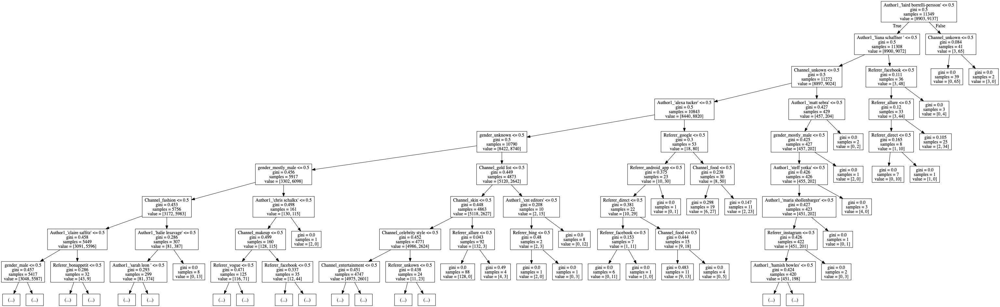

In [353]:
Image(filename = 'tree5_limited.png')

In [354]:
export_graphviz(estimator_5, out_file='tree_limited_5.dot', feature_names = X_train.columns, max_depth= 8,
                rounded = True, filled = True)

In [355]:
!dot -Tpng tree_limited_5.dot -o tree_limited_5.png

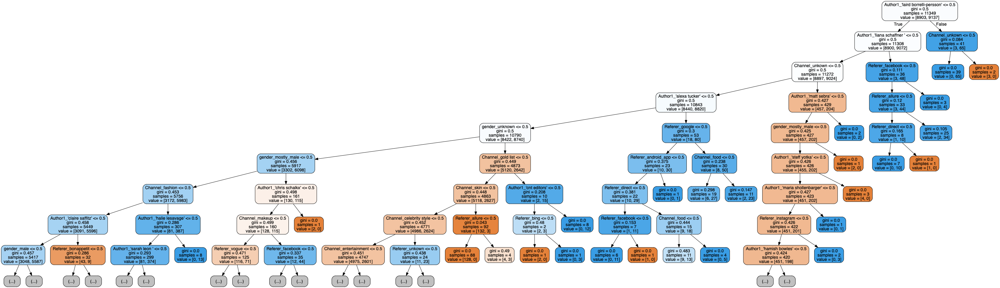

In [356]:
Image(filename = 'tree_limited_5.png')

In [ ]:
####old

In [136]:
X = pd.get_dummies(df[['Brand', 'Channel', 'Category', 'Location', 'Browser', 'Referer', 'Author1','gender']], drop_first=True)
X = pd.concat([X, keyword_feature_df], axis=1)
X.shape

(20000, 22537)

In [133]:
df.columns

Index(['index', 'InfinityID', 'UUID', 'Brand', 'Channel', 'Author', 'Category',
       'Location', 'Country', 'ScrollDepth', 'Browser', 'ScrollDepth_count',
       'Referer', 'Author1', 'gender', 'cut_q', 'clean_title',
       'clean_keyword'],
      dtype='object')

#### Using PCA to reduce demension

In [83]:
X.head(n=3)

,Brand_architectural-digest,Brand_ars-technica,Brand_bon-appetit,Brand_brides,Brand_conde-nast-traveler,Brand_epicurious,Brand_glamour,Brand_golf-digest,Brand_gq,Brand_pitchfork,...,zuckerbrot,zuhair,zuma,zumba,zunino,zurab,zurich,zwill,zwilling,zwirner
0,0,0,1,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0,0,0,0,0,1,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [84]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [85]:
scaled_data = StandardScaler().fit_transform(X)
scaled_data=pd.DataFrame(scaled_data)
scaled_data.head()

/Users/rona/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:625: DataConversionWarning: Data with input dtype uint8, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/Users/rona/anaconda3/lib/python3.7/site-packages/sklearn/base.py:462: DataConversionWarning: Data with input dtype uint8, float64 were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


,0,1,2,3,4,5,6,7,8,9,...,35581,35582,35583,35584,35585,35586,35587,35588,35589,35590
0,-0.182843,-0.209643,3.693411,-0.182989,-0.281761,-0.279480,-0.21682,-0.167214,-0.278543,-0.173889,...,-0.007071,-0.00998,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.009842,-0.010001
1,-0.182843,-0.209643,-0.270752,-0.182989,-0.281761,3.578075,-0.21682,-0.167214,-0.278543,-0.173889,...,-0.007071,-0.00998,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.009842,-0.010001
2,-0.182843,-0.209643,-0.270752,-0.182989,-0.281761,-0.279480,-0.21682,-0.167214,-0.278543,-0.173889,...,-0.007071,-0.00998,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.009842,-0.010001
3,-0.182843,-0.209643,-0.270752,-0.182989,-0.281761,-0.279480,-0.21682,-0.167214,-0.278543,-0.173889,...,-0.007071,-0.00998,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.009842,-0.010001
4,-0.182843,-0.209643,-0.270752,-0.182989,-0.281761,-0.279480,-0.21682,-0.167214,-0.278543,-0.173889,...,-0.007071,-0.00998,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.007071,-0.009842,-0.010001


In [ ]:
#Fitting the PCA algorithm
pca = PCA().fit(scaled_data)

#Plotting the Cumulative Summation of the Explained Variance
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Dataset Explained Variance')
plt.axvline(x=10000,c='r',ls='--')
plt.show()

print(np.cumsum(pca.explained_variance_ratio_)[7500])

In [124]:
pca = PCA(n_components=7500)
dataset_pca = pca.fit_transform(scaled_data)

In [126]:
dataset_pca.shape

(20000, 7500)

In [131]:
pd.DataFrame(dataset_pca).head()

,0,1,2,3,4,5,6,7,8,9,...,7490,7491,7492,7493,7494,7495,7496,7497,7498,7499
0,-0.217144,-0.019409,-0.773184,-0.041335,-0.062531,-0.093777,-0.225839,-0.082203,-0.075994,-0.063511,...,-0.219882,-0.433311,0.446003,-0.098149,0.051370,1.356187,-1.612134,-0.455959,0.885477,0.834606
1,-0.222304,-0.076635,-0.501644,-0.065976,-0.033542,-0.050184,-0.246890,-0.066273,-0.071966,-0.019211,...,-0.308323,0.322577,0.911365,0.184836,0.449205,-1.067664,0.861856,-0.140666,-0.726603,1.294917
2,0.287796,0.025094,-1.223905,-0.039064,-0.134770,-0.021552,-1.421552,0.338230,0.096254,0.603968,...,-0.691449,-0.231020,0.480892,0.029610,0.119041,0.184066,-0.470666,-0.349426,-0.534714,-0.467477
3,0.412281,0.131598,-1.097954,0.032515,-0.090895,-0.028108,-1.236254,0.089842,0.088641,0.556585,...,-0.712106,1.282736,1.953152,-0.781955,-0.681623,-0.163933,1.067497,2.530023,-2.507168,-2.421424
4,-0.040186,-0.010819,-0.726343,0.302040,-0.067568,0.080467,-0.937613,-0.101520,1.220538,-0.949788,...,-0.433772,-0.151721,0.335511,0.382023,0.117117,-0.208110,-0.034718,0.307147,-0.136860,0.072568


#### Random Forest

In [134]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_regression
from sklearn import datasets, linear_model

In [127]:
y = df['ScrollDepth_count'].values
y.shape

(20000,)

In [141]:
np.random.seed(1234)
X_train, X_test, y_train, y_test = train_test_split(dataset_pca, y, test_size = 0.2) 

train_scores = []
test_scores = []
rf = RandomForestClassifier(warm_start=True)
estimator_range = range(100, 1000, 10)
for n_estimators in estimator_range:
    rf.n_estimators = n_estimators
    rf.fit(X_train, y_train)
    train_scores.append(rf.score(X_train, y_train))
    test_scores.append(rf.score(X_test, y_test))

In [149]:
from matplotlib.legend_handler import HandlerLine2D

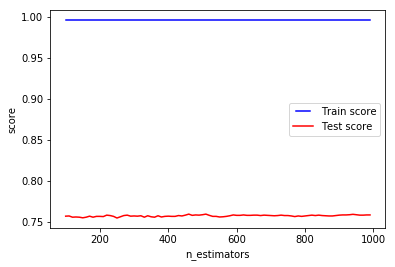

In [152]:
n_estimators = [*range(100, 1000, 10)]
line1, = plt.plot(n_estimators, train_scores, 'b', label='Train score')
line2, = plt.plot(n_estimators, test_scores, 'r', label='Test score')
plt.legend(handler_map={line1: HandlerLine2D(numpoints=2)})
plt.ylabel('score')
plt.xlabel('n_estimators')
plt.show()

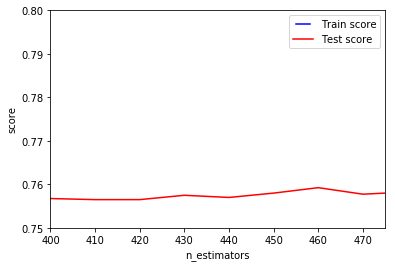

In [171]:
#zoom in
line1, = plt.plot(n_estimators, train_scores, 'b', label='Train score')
line2, = plt.plot(n_estimators, test_scores, 'r', label='Test score')
plt.legend(handler_map={line1: HandlerLine2D(numpoints=2)})
plt.ylabel('score')
plt.xlabel('n_estimators')
plt.ylim(0.75,0.8)
plt.xlim(400,475)
plt.show()

based on the above graph, choose n_estimators to be 460 in this case

In [173]:
rf_optimal = RandomForestClassifier(n_estimators = 460, random_state = 123) 
rf_optimal.fit(X_train, y_train)  

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=460, n_jobs=None,
            oob_score=False, random_state=123, verbose=0, warm_start=False)

In [195]:
estimator_nolimited = rf_optimal.estimators_[5]
estimator_nolimited

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False,
            random_state=819844194, splitter='best')

In [196]:
from sklearn.tree import export_graphviz

In [188]:
#!pip install gprof2dot

  Running setup.py bdist_wheel for gprof2dot ... done
  Stored in directory: /Users/rona/Library/Caches/pip/wheels/0f/20/4e/416cc3d5d870aff6a0aafacbc6f00ea9294fcadd026483b5a9
Successfully built gprof2dot


In [181]:
X_train=pd.DataFrame(X_train)

In [197]:
# Export as dot file
export_graphviz(estimator_nolimited, out_file='tree_nolimited.dot', feature_names = X_train.columns,
                rounded = True, filled = True)

In [201]:
#os.system('dot -Tpng tree_nolimited.dot -o tree_nolimited.png')

In [200]:
!dot -Tpng tree_nolimited.dot -o tree_nolimited.png

In [202]:
from IPython.display import Image
Image(filename = 'tree_nolimited.png')

#### add limited : max_depth = 5

In [203]:
rf_limited = RandomForestClassifier(n_estimators = 460,max_depth = 5, random_state = 122)
rf_limited.fit(X_train, y_train)
estimator_limited = rf_limited.estimators_[5]
estimator_limited

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=5,
            max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False,
            random_state=1444879166, splitter='best')

In [204]:
export_graphviz(estimator_limited, out_file='tree_limited.dot', feature_names = X_train.columns,
                rounded = True, filled = True)

In [205]:
!dot -Tpng tree_limited.dot -o tree_limited.png

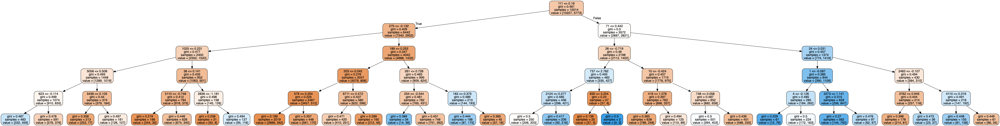

In [206]:
Image(filename = 'tree_limited.png')

#### Prediction Using Random Forest Model

Training Accuracy for rf:  0.9958125
Test Accuracy for rf:  0.7595
AUC score is:  0.6957829398184044
      0    1
0  2364  194
1   768  674
              precision    recall  f1-score   support

           0       0.75      0.92      0.83      2558
           1       0.78      0.47      0.58      1442

   micro avg       0.76      0.76      0.76      4000
   macro avg       0.77      0.70      0.71      4000
weighted avg       0.76      0.76      0.74      4000



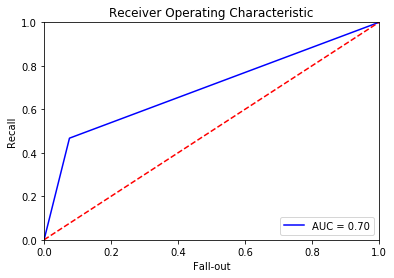

In [210]:
y_pred_train_rf = rf_optimal.predict(X_train)
y_pred_test_rf = rf_optimal.predict(X_test)

y_pred_train_rf_0_1 = y_pred_train_rf > 0.5
y_pred_test_rf_0_1 = y_pred_test_rf > 0.5

print("Training Accuracy for rf: ", accuracy_score(y_train, y_pred_train_rf_0_1))
print("Test Accuracy for rf: ", accuracy_score(y_test, y_pred_test_rf_0_1))
print('AUC score is: ', metrics.roc_auc_score(y_test, y_pred_test_rf))
print(pd.DataFrame(metrics.confusion_matrix(y_test, y_pred_test_rf_0_1)))
print(metrics.classification_report(y_test, y_pred_test_rf_0_1))

from sklearn.metrics import roc_curve,auc
false_positive_rate, recall, thresholds = roc_curve(y_test, y_pred_test_rf)
roc_auc=auc(false_positive_rate,recall)
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate, recall, 'b', label='AUC = %0.2f' % roc_auc)
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.0])
plt.ylabel('Recall')
plt.xlabel('Fall-out')
plt.show()

#### Variable importance

In [218]:
var_imp = sorted(zip(map(lambda x: round(x, 4), rf_optimal.feature_importances_),X_train.columns), reverse=True)
var_imp_df = pd.DataFrame(var_imp)
var_imp_df.head(n=10)

,0,1
0,0.0051,12
1,0.0037,43
2,0.0036,13
3,0.0033,246
4,0.0030,27
5,0.0028,35
6,0.0027,28
7,0.0026,71
8,0.0026,51
9,0.0026,42


In [220]:
var_imp_original = sorted(zip(map(lambda x: round(x, 4), rf_optimal.feature_importances_),X.columns), reverse=True)
var_imp_original = pd.DataFrame(var_imp_original)
var_imp_original.head(n=10)

,0,1
0,0.0051,Brand_the-new-yorker
1,0.0037,Channel_about
2,0.0036,Brand_vanity-fair
3,0.0033,Channel_sponsored
4,0.0030,Channel_/contributor/pete mortensen
5,0.0028,Channel_/tag/edtech
6,0.0027,Channel_/contributor/wired staff
7,0.0026,Channel_cartoons
8,0.0026,Channel_architecture design
9,0.0026,Channel__home
